# New Advances in Python Data Visualization

This presentation takes six data visualization libraries in Python and runs them through some tests to determine which ones are the most performant, easiest to use, and result in the most beautiful visuals.

### The Old Standards
* matplotlib
* seaborn

### The New Generation
* bokeh
* plotnine
* Altair
* Plotly

In [1]:
import matplotlib.pyplot as plt
import seaborn as sns

import bokeh as bk

from plotnine import *
import plotnine.options as pno

import altair as alt

import plotly.express as px
import plotly.graph_objects as go

import pandas as pd
import numpy as np

# Installs with pip3

## Dataset

For the tests we're doing, we'll use the Kaggle Spotify Tracks dataset. This includes assorted numeric and categorical columns, and a bit more than 20,000 rows so we can do a reasonable test of high volumes of data that ought to be handled well by a robust tool.

In [2]:
dataset = pd.read_csv("data.csv")
dataset.head()

,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo,valence,year
0,0.995,['Carl Woitschach'],0.708,158648,0.1950,0,6KbQ3uYMLKb5jDxLF7wYDD,0.563,10,0.1510,-12.428,1,Singende Bataillone 1. Teil,0,1928,0.0506,118.469,0.7790,1928
1,0.994,"['Robert Schumann', 'Vladimir Horowitz']",0.379,282133,0.0135,0,6KuQTIu1KoTTkLXKrwlLPV,0.901,8,0.0763,-28.454,1,"Fantasiestücke, Op. 111: Più tosto lento",0,1928,0.0462,83.972,0.0767,1928
2,0.604,['Seweryn Goszczyński'],0.749,104300,0.2200,0,6L63VW0PibdM1HDSBoqnoM,0.000,5,0.1190,-19.924,0,Chapter 1.18 - Zamek kaniowski,0,1928,0.9290,107.177,0.8800,1928
3,0.995,['Francisco Canaro'],0.781,180760,0.1300,0,6M94FkXd15sOAOQYRnWPN8,0.887,1,0.1110,-14.734,0,Bebamos Juntos - Instrumental (Remasterizado),0,1928-09-25,0.0926,108.003,0.7200,1928
4,0.990,"['Frédéric Chopin', 'Vladimir Horowitz']",0.210,687733,0.2040,0,6N6tiFZ9vLTSOIxkj8qKrd,0.908,11,0.0980,-16.829,1,"Polonaise-Fantaisie in A-Flat Major, Op. 61",1,1928,0.0424,62.149,0.0693,1928


In [3]:
dataset.describe()


,acousticness,danceability,duration_ms,energy,explicit,instrumentalness,key,liveness,loudness,mode,popularity,speechiness,tempo,valence,year
count,169909.000000,169909.000000,1.699090e+05,169909.000000,169909.000000,169909.000000,169909.000000,169909.000000,169909.000000,169909.000000,169909.000000,169909.000000,169909.000000,169909.000000,169909.000000
mean,0.493214,0.538150,2.314062e+05,0.488593,0.084863,0.161937,5.200519,0.206690,-11.370289,0.708556,31.556610,0.094058,116.948017,0.532095,1977.223231
std,0.376627,0.175346,1.213219e+05,0.267390,0.278679,0.309329,3.515257,0.176796,5.666765,0.454429,21.582614,0.149937,30.726937,0.262408,25.593168
min,0.000000,0.000000,5.108000e+03,0.000000,0.000000,0.000000,0.000000,0.000000,-60.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1921.000000
25%,0.094500,0.417000,1.710400e+05,0.263000,0.000000,0.000000,2.000000,0.098400,-14.470000,0.000000,12.000000,0.034900,93.516000,0.322000,1957.000000
50%,0.492000,0.548000,2.086000e+05,0.481000,0.000000,0.000204,5.000000,0.135000,-10.474000,1.000000,33.000000,0.045000,114.778000,0.544000,1978.000000
75%,0.888000,0.667000,2.629600e+05,0.710000,0.000000,0.086800,8.000000,0.263000,-7.118000,1.000000,48.000000,0.075400,135.712000,0.749000,1999.000000
max,0.996000,0.988000,5.403500e+06,1.000000,1.000000,1.000000,11.000000,1.000000,3.855000,1.000000,100.000000,0.969000,244.091000,1.000000,2020.000000


## The Competition

We'll start with really easy visuals, and gradually try harder or more complicated techniques.

We're testing to decide which tool:
* is easier to write
* produces shorter code
* produces readable code, with predictable grammar
* renders beautiful results naturally
* has robust capabilities

As a bonus, some of these tools allow interactivity, but we won't use that as a huge deal breaker.


Other factors:
* can it do minor data manipulation to make visualizing easier?
* grammar approach: adding layers to objects, then calling `show` versus creating a single layered object and calling its name to show

## Histogram Test

Univariate, numeric data. No grouping or multiple facets.

### Matplotlib

Standard, well known. Does bin the data for us. Results not beautiful without a lot of work. Every element has to be added in a separate layer. Must call `.show()` to render.

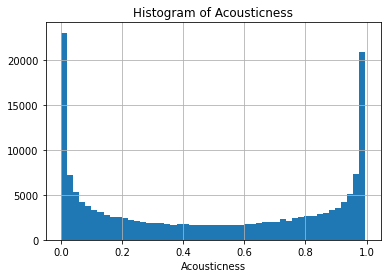

In [14]:
n, bins, patches = plt.hist(dataset.acousticness, 50)
plt.xlabel('Acousticness')
plt.title('Histogram of Acousticness')
plt.grid(True)
plt.show()

### Seaborn

Also well known and widely used. Bins data for us. Every element needs to be added in a separate layer. Can render by calling object name.

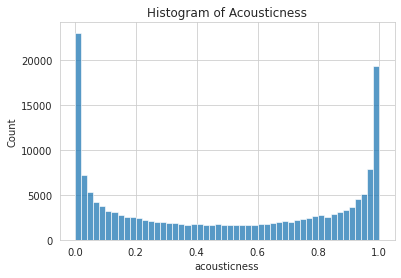

In [24]:
with sns.axes_style("whitegrid"):
    viz = sns.histplot(data=dataset, x="acousticness",  binwidth=.02)
    viz.set_title("Histogram of Acousticness")
    viz

### Bokeh

Must specify whether output is for notebook or file. Rendering is resource heavy and takes some time. Tool will not do bins for you, must create numpy object first. This approach is actually creating rectangles to pretend it is a histogram. Many figure details can be specified in single command. Must use `show()` to render. Highly interactive and beautiful resulting graph.

In [20]:
from bokeh.io import show, output_notebook
from bokeh.plotting import figure

output_notebook()
hist, edges = np.histogram(dataset.acousticness, bins=50)

p = figure(title="Histogram of Acousticness", 
           y_axis_label='Count', 
           x_axis_label='Acousticness', 
           width=600, 
           height = 300)

p.quad(top=hist, bottom=0, left=edges[:-1], right=edges[1:])
show(p)

Loading BokehJS ...

### Altair

Tool cannot handle the full complement of data, must limit to < 5000 rows. Returns very beautiful graphs. Layering elements on to object, can return without using `show`.

In [28]:
source = dataset.sample(axis = 0, n=4000)

viz = alt.Chart(source)
viz = viz.mark_bar()
viz = viz.encode(alt.X("acousticness", bin=True),y='count()')
viz = viz.properties(title='Histogram of Acousticness')

viz


alt.Chart(...)

### Plotnine

Emulates the ggplot grammar from R. May not feel "pythonic" if you like the layering approach. Readability high, the geom strategy seems to be well liked. 

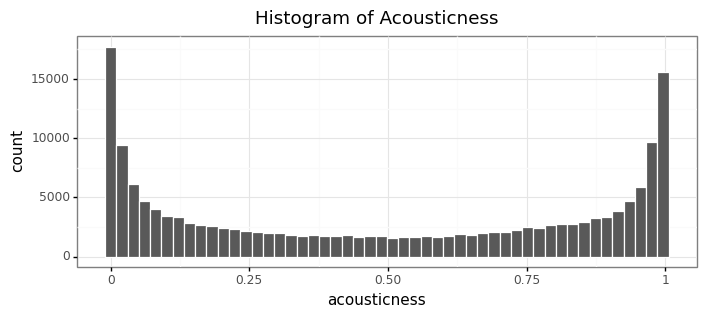

<ggplot: (323486657)>

In [23]:

pno.dpi = (100)
pno.figure_size = (8,3)
ggplot(data=dataset, mapping=aes(x='acousticness')) + \
    theme_bw() + \
    geom_histogram(color='white', bins=50) + \
    labs(title = "Histogram of Acousticness")

### Plotly

Create base object and set many traits with one call. Changing style can be handled in mostly one command. Requires `.show()` to render. Highly interactive, renders faster than bokeh. Not very beautiful default image.

In [9]:
fig = px.histogram(dataset, x="acousticness", nbins=50, title="Histogram of Acousticness", template='plotly_white')
fig.update_layout(
    width=700,height=400,
    margin=dict(l=15,r=25,b=15,t=40,pad=1))
fig.show()

## Histogram Results

Unscientific rankings by me, 1 = best, 6 = worst.


|            |features     |beauty    |ease of use   |
|------------|-------------|----------|--------|
|matplotlib  |   4         |   6      |   5    |
|seaborn     |   3         |   4      |   1    |
|bokeh       |   5         |   2      |   6    |
|altair      |   6         |   1      |   4    |
|plotnine    |   2         |   3      |   3    |
|plotly      |   1         |   5      |   2    |




## Scatterplot Test

Bivariate, numeric data.


### Matplotlib
Highly abbreviated arguments, makes it hard to intuit the grammar.

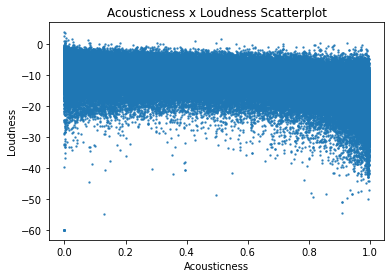

In [36]:
plt.scatter(x=dataset.acousticness, y=dataset.loudness, alpha=0.75, s=2)
plt.title('Acousticness x Loudness Scatterplot')
plt.xlabel('Acousticness')
plt.ylabel('Loudness')
plt.show()

### Seaborn


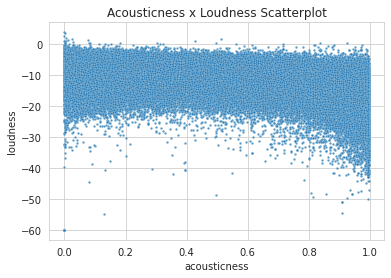

In [42]:
with sns.axes_style("whitegrid"):
    viz = sns.scatterplot(data=dataset, x="acousticness", y='loudness', alpha = .75, s = 6)
    viz.set_title("Acousticness x Loudness Scatterplot")
    viz

### Bokeh

In [77]:
output_notebook()

p = figure(title="Acousticness x Loudness Scatterplot", 
           y_axis_label='Loudness', 
           x_axis_label='Acousticness', 
           width=600, 
           height = 300)

p.scatter(x=dataset.acousticness, y=dataset.loudness, marker='circle',
            line_color="#6666ee", fill_color="#ee6666", fill_alpha=0.75, size=5)

show(p)

Loading BokehJS ...

### Altair


In [50]:
source = dataset.sample(axis = 0, n=4000)

viz = alt.Chart(source)
viz = viz.mark_circle(size = 6)
viz = viz.encode(alt.X("acousticness"),y='loudness')
viz = viz.properties(title='Acousticness x Loudness Scatterplot')

viz

alt.Chart(...)

### Plotnine


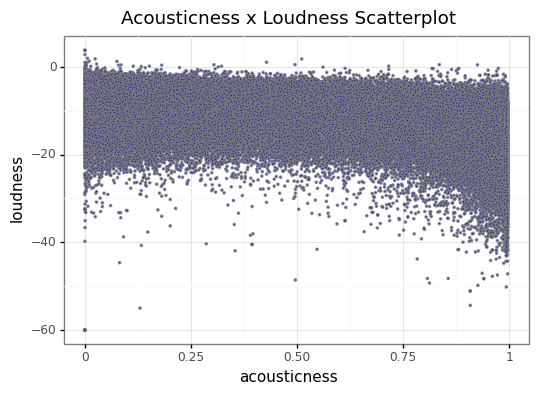

<ggplot: (322192104)>

In [61]:
pno.dpi = (100)
pno.figure_size = (6,4)
ggplot(data=dataset, mapping=aes(x='acousticness', y='loudness')) + \
    theme_bw() + \
    geom_point(size = .5, fill = 'darkblue', alpha = .75, color = "gray") + \
    labs(title = "Acousticness x Loudness Scatterplot")

### Plotly

Setting element visual traits requires passing vectors the same length as data, column names, etc. Can't just pass a constant.

In [76]:

fig = px.scatter(dataset, 
                 x="acousticness", 
                 y='loudness', 
                 title="Acousticness x Loudness Scatterplot", 
                 template='plotly_white')
fig.update_layout(
    width=700,height=400,
    margin=dict(l=15,r=25,b=15,t=40,pad=1))
fig.show()

## Scatterplot Results

Unscientific rankings by me, 1 = best, 6 = worst. Ease of use now includes consistency in the grammar making it easier to move from histogram to scatterplot also.


|            |features     |beauty    |ease of use   |
|------------|-------------|----------|--------|
|matplotlib  |    6        |    3     |   6   |
|seaborn     |    4        |    5     |   4   |
|bokeh       |    1        |    1     |   1   |
|altair      |    3        |    2     |   3   |
|plotnine    |    2        |    4     |   2   |
|plotly      |    5        |    6     |   5   |

